In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Topic: EX2 - Turbofan RUL Prediction
**Task**: Predict the remaining useful life (RUL) of turbofan engines based on given sensor data (time series data). It is a regression problem.
**Data**: Turbofan engine degradation simulation data (NASA) - [Link](https://data.nasa.gov/dataset/Turbofan-Engine-Degradation-Simulation-Data-Set/vrks-gjie). See also in the topic [introduction notebook](https://github.com/nina-prog/damage-propagation-modeling/blob/2fb8c1a1102a48d7abbf04e4031807790a913a99/notebooks/Turbofan%20remaining%20useful%20life%20Prediction.ipynb).

**Subtasks**:
1. Perform a deep **exploratory data analysis (EDA)** on the given data. -> 🎯 **Focus on this task**
2. Implement a more efficient **sliding window method** for time series data analysis. 
3. Apply **traditional machine learning methods** (SOTA) to predict the remaining useful life. Includes data preparation, feature extraction, feature selection, model selection, and model parameter optimization.
4. Create **neural network models** to predict the remaining useful life. Includes different architectures like Convolutional Neural Networks (CNN), Recurrent Neural Networks (RNN), or Attention Models. Note: You can search for SOTA research papers and reproduce current state-of-the-art models.


# Imports + Settings

In [3]:
# third-party libraries
import pandas as pd
import numpy as np
import os
import time
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
# source code
from src.data_loading import load_data, load_config
from src.plotting import plot_sensor_measures_from_motor, plot_sensor_measures_from_dataset
from src.rolling_window_creator import calculate_RUL
from src.feature_engineering import extract_num_of_peaks_from_sensor_signals

In [5]:
# settings
sns.set_style("whitegrid")
sns.set_palette("Set2")
sns.set(rc={"figure.dpi":100, 'savefig.dpi':200})
sns.set_context('notebook')

In [6]:
np.random.seed(42)

# Paths

In [7]:
# Make sure to execute this cell only once for one kernel session, before running any other cell below.
os.chdir("../") # set working directory to root of project
os.getcwd() # check current working directory

'C:\\Users\\merti\\PycharmProjects\\damage-propagation-modeling'

In [8]:
PATH_TO_CONFIG = "configs/config.yaml"

# Load Config + Data
By looking through given resources, we can summarize the following main information about the dataset beforehand. Dataset Overview:
* Multiple engines running simultaneously under different conditions and fault modes
* Four test scenarios: FD001, FD002, FD003, FD004
* Files included in the dataset:
    * Training sets: ``train_FD001.txt``, ``train_FD002.txt``, ``train_FD003.txt``, ``train_FD004.txt``
    * Test sets: ``test_FD001.txt``, ``test_FD002.txt``, ``test_FD003.txt``, ``test_FD004.txt``
    * RUL files: ``RUL_FD001.txt``, ``RUL_FD002.txt``, ``RUL_FD003.txt``, ``RUL_FD004.txt``
* Each training and test dataset has the following columns:
    * 1 engine unit number (column 1) - serves as the identifier for the engine
    * 1 cycle number (column 2) - serves as the time indicator for the engine
    * 3 operational settings (columns 3-5)
    * 21 sensor measurements (columns 6-26)

We will load the data for the four datasets (FD001, FD002, FD003, FD004) and the corresponding RUL data. The data loading process is implemented in the `load_data` method in the `src/data_loading.py` file. The method returns the training data, test data, and the RUL data for each dataset. The method `load_config` loads the configuration file `config.yaml` which contains all relevant paths and parameters necessary for the data loading process and other parts of the project to ensure a consistent configuration which can be easily adjusted and maintained.

In [9]:
config = load_config(PATH_TO_CONFIG) # config is dict

In [10]:
train_data_1, test_data_1, test_RUL_data_1 = load_data(config_path=PATH_TO_CONFIG, dataset_num=1)

2024-06-01 20:38:46 [src.data_loading:43] [INFO] >>>> Loading data set 1...
2024-06-01 20:38:47 [src.data_loading:72] [INFO] >>>> Loaded raw data for dataset 1.
2024-06-01 20:38:47 [src.data_loading:73] [INFO] >>>> Train Data: (20631, 26)
2024-06-01 20:38:47 [src.data_loading:74] [INFO] >>>> Test Data: (13096, 26)
2024-06-01 20:38:47 [src.data_loading:75] [INFO] >>>> Test RUL Data: (100, 1)


In [11]:
train_data_2, test_data_2, test_RUL_data_2 = load_data(config_path=PATH_TO_CONFIG, dataset_num=2)

2024-06-01 20:38:47 [src.data_loading:43] [INFO] >>>> Loading data set 2...
2024-06-01 20:38:47 [src.data_loading:72] [INFO] >>>> Loaded raw data for dataset 2.
2024-06-01 20:38:47 [src.data_loading:73] [INFO] >>>> Train Data: (53759, 26)
2024-06-01 20:38:47 [src.data_loading:74] [INFO] >>>> Test Data: (33991, 26)
2024-06-01 20:38:47 [src.data_loading:75] [INFO] >>>> Test RUL Data: (259, 1)


In [12]:
train_data_3, test_data_3, test_RUL_data_3 = load_data(config_path=PATH_TO_CONFIG, dataset_num=3)

2024-06-01 20:38:48 [src.data_loading:43] [INFO] >>>> Loading data set 3...
2024-06-01 20:38:48 [src.data_loading:72] [INFO] >>>> Loaded raw data for dataset 3.
2024-06-01 20:38:48 [src.data_loading:73] [INFO] >>>> Train Data: (24720, 26)
2024-06-01 20:38:48 [src.data_loading:74] [INFO] >>>> Test Data: (16596, 26)
2024-06-01 20:38:48 [src.data_loading:75] [INFO] >>>> Test RUL Data: (100, 1)


In [13]:
train_data_4, test_data_4, test_RUL_data_4 = load_data(config_path=PATH_TO_CONFIG, dataset_num=4)

2024-06-01 20:38:48 [src.data_loading:43] [INFO] >>>> Loading data set 4...
2024-06-01 20:38:49 [src.data_loading:72] [INFO] >>>> Loaded raw data for dataset 4.
2024-06-01 20:38:49 [src.data_loading:73] [INFO] >>>> Train Data: (61249, 26)
2024-06-01 20:38:49 [src.data_loading:74] [INFO] >>>> Test Data: (41214, 26)
2024-06-01 20:38:49 [src.data_loading:75] [INFO] >>>> Test RUL Data: (248, 1)


In [14]:
train_data = [train_data_1, train_data_2, train_data_3, train_data_4]
test_data = [test_data_1, test_data_2, test_data_3, test_data_4]

# 📍 Subtask 1: Exploratory Data Analysis

## Target Variable ```Remaining Useful Life (RUL)``` Calculation
The target variable for the turbofan engine degradation simulation data is the Remaining Useful Life (RUL). The RUL is the number of operational cycles remaining until the engine fails. This process is implemented with a linear degradation method or a piecewise linear degradation method. The RUL is calculated for each unit in the dataset.

We implemented two different approaches to be later on compared based on the performance of the models:
1. Piecewise linear degradation model: A more realistic model, based on the assumption that the degradation of the engine is not linear over the whole life cycle, but rather consists of several linear segments. In this context there is an early RUL, which is a constant. This is set until the actual RUL is reached, then the degradation is linear. The early RUL is a hyperparameter that can be set.
    * Example: If the early RUL is set to 100, the RUL is 100 until the actual RUL reaches 100, then the degradation is linear. For implementation, we can calculate the RUL for each unit with a linear degradation model, but we afterward clip the RUL at a certain value (early RUL).
2. Linear Degradation: A simple linear degradation model, where the RUL is calculated based on the remaining cycles until the engine fails. Where the minimum RUL is 1 indicating that the engine will fail in the next cycle.
    * Example: If the engine has a total of 200 cycles, at cycle 1 the RUL is 200, at cycle 2 the RUL is 199, and so on til cycle 200 where the RUL is 1.

The piecewise and linear degradation model is implemented in the `calculate_RUL` function in the `rolling_window_creator.py` file.

For a better understanding of the RUL calculation, we will visualize the RUL for some random units in the dataset 1 using both degradation models.

In [15]:
clipping_val = 150
picewise_deg = calculate_RUL(train_data_1, time_column="Cycle", group_column="UnitNumber", clipping_value_of_RUL=clipping_val)
lin_deg = calculate_RUL(train_data_1, time_column="Cycle", group_column="UnitNumber", clipping_value_of_RUL=None)

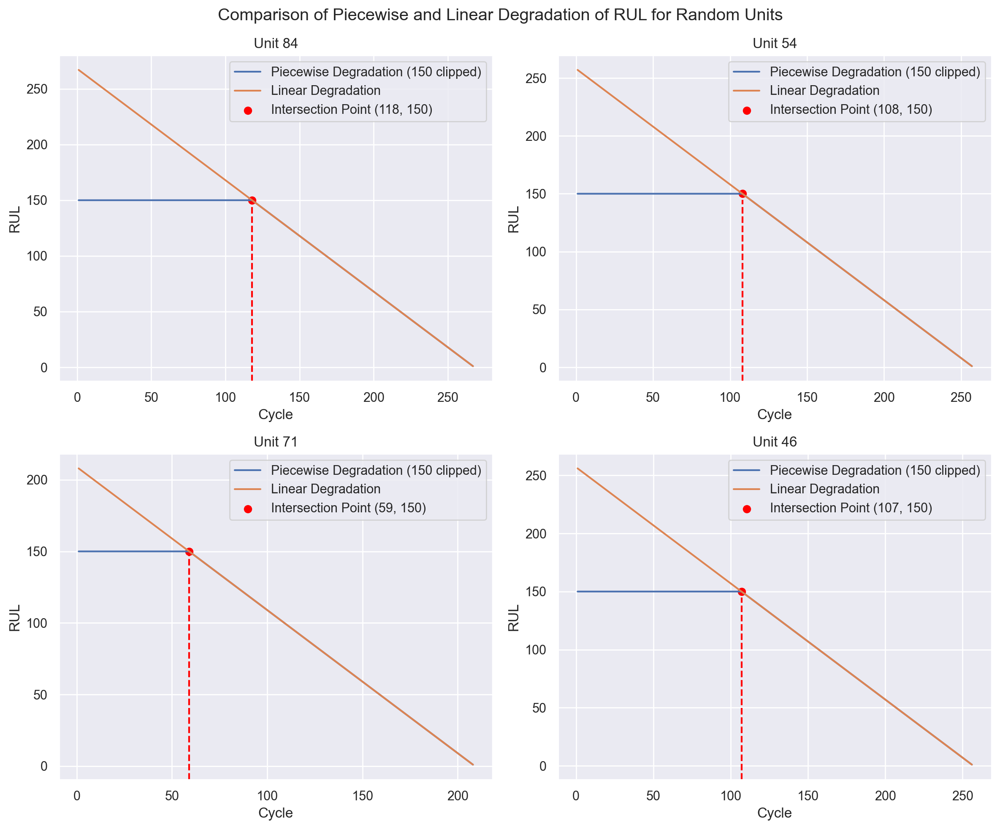

In [16]:
i = 4

num_cols = 2
num_rows = int(np.ceil(i / num_cols))
units = np.random.choice(picewise_deg["UnitNumber"].unique(), i, replace=False)

fig, ax = plt.subplots(num_rows, num_cols, figsize=(12, 10))
for idx, unit in enumerate(units):
    # plot piecewise and linear degradation
    sns.lineplot(data=picewise_deg[picewise_deg["UnitNumber"]==unit], x="Cycle", y="RUL", ax=ax[idx//num_cols, idx%num_cols], label=f"Piecewise Degradation ({clipping_val} clipped)")
    # plot linear degradation
    sns.lineplot(data=lin_deg[lin_deg["UnitNumber"]==unit], x="Cycle", y="RUL", ax=ax[idx//num_cols, idx%num_cols], label="Linear Degradation")
    # set title, labels
    ax[idx//num_cols, idx%num_cols].set_title(f"Unit {unit}")
    ax[idx//num_cols, idx%num_cols].set_xlabel("Cycle")
    ax[idx//num_cols, idx%num_cols].set_ylabel("RUL")
    # get first intersection point of both degradation curves
    intersection_point = picewise_deg[picewise_deg["UnitNumber"]==unit].merge(lin_deg[lin_deg["UnitNumber"]==unit], on="Cycle", suffixes=("_piecewise", "_linear"))
    intersection_point = intersection_point[intersection_point["RUL_piecewise"] == intersection_point["RUL_linear"]].iloc[0]
    # plot intersection point and add vertical line up to the intersection point
    ax[idx//num_cols, idx%num_cols].scatter(intersection_point["Cycle"], intersection_point["RUL_piecewise"], color="red", label=f"Intersection Point ({int(intersection_point['Cycle'])}, {int(intersection_point['RUL_piecewise'])})")
    ymax_fraction = intersection_point["RUL_piecewise"] / ax[idx//num_cols, idx%num_cols].get_ylim()[1]
    ax[idx//num_cols, idx%num_cols].axvline(intersection_point["Cycle"], color="red", linestyle="--", ymax=ymax_fraction)
    ax[idx//num_cols, idx%num_cols].legend()
plt.suptitle("Comparison of Piecewise and Linear Degradation of RUL for Random Units")
plt.tight_layout()
plt.show()

Findings:
* The picewise linear degradation model shows the expected behavior. The RUL is constant until the early RUL is reached, then the degradation is linear.
* Can be seen in the plots where the intersection point of the two degradation curves is the point where the early RUL is reached and the linear degradation starts.

In [17]:
time_column = 'Cycle'
group_column = 'UnitNumber'

In [18]:
# Calculate RUL for all datasets
train_data = [calculate_RUL(train_data_1, time_column, group_column), calculate_RUL(train_data_2, time_column, group_column), calculate_RUL(train_data_3, time_column, group_column), calculate_RUL(train_data_4, time_column, group_column)]
train_data_1 = train_data[0]
train_data_2 = train_data[1]
train_data_3 = train_data[2]
train_data_4 = train_data[3]

## Analyzing Dataset Stats

In [19]:
# check dataset characteristics (train and test data)
for i, train_data_x in enumerate(train_data):
    print(f"Dataset FD00{i+1}")
    print(f"Number of engines: train {train_data_x['UnitNumber'].nunique()}, test {test_data[i]['UnitNumber'].nunique()}")
    print(f"Number of features: train {train_data_x.drop('RUL', axis=1).shape[1]}, test {test_data[i].shape[1]}")
    print(f"Number of missing values: train {train_data_x.isna().sum().sum()}, test {test_data[i].isna().sum().sum()}")
    print(f"Number of features with constant values for all units: train {train_data_x.columns[(train_data_x.nunique() == 1)].shape[0]}, test {test_data[i].columns[(test_data[i].nunique() == 1)].shape[0]}")
    print()

Dataset FD001
Number of engines: train 100, test 100
Number of features: train 26, test 26
Number of missing values: train 0, test 0
Number of features with constant values for all units: train 7, test 7

Dataset FD002
Number of engines: train 260, test 259
Number of features: train 26, test 26
Number of missing values: train 0, test 0
Number of features with constant values for all units: train 0, test 0

Dataset FD003
Number of engines: train 100, test 100
Number of features: train 26, test 26
Number of missing values: train 0, test 0
Number of features with constant values for all units: train 6, test 6

Dataset FD004
Number of engines: train 249, test 248
Number of features: train 26, test 26
Number of missing values: train 0, test 0
Number of features with constant values for all units: train 0, test 0



In [20]:
# check vor NaN, 0.0 values
for i, train_data_x in enumerate(train_data):
    print(f"Dataset FD00{i+1}")
    empty_value_count = train_data_x.isna().sum().rename("NaN").to_frame().join(train_data_x.eq(0.0).sum().rename("0.0"))
    empty_value_count["total"] = empty_value_count.sum(axis=1)
    empty_value_count["total %"] = (empty_value_count["total"] / train_data_x.shape[0] * 100).round(2)
    empty_value_count = empty_value_count[empty_value_count["total"] != 0]
    print(empty_value_count)
    print()

Dataset FD001
                     NaN   0.0  total  total %
Operation Setting 1    0   413    413     2.00
Operation Setting 2    0  2070   2070    10.03

Dataset FD002
                     NaN   0.0  total  total %
Operation Setting 1    0   145    145     0.27
Operation Setting 2    0  4187   4187     7.79

Dataset FD003
                     NaN   0.0  total  total %
Operation Setting 1    0   413    413     1.67
Operation Setting 2    0  2451   2451     9.92

Dataset FD004
                     NaN   0.0  total  total %
Operation Setting 1    0   162    162     0.26
Operation Setting 2    0  4776   4776     7.80



In [21]:
# check for duplicates
for i, train_data_x in enumerate(train_data):
    print(f"Dataset FD00{i+1}")
    print(f"Number of duplicates: {train_data_x.duplicated().sum()}")
    print()

Dataset FD001
Number of duplicates: 0

Dataset FD002
Number of duplicates: 0

Dataset FD003
Number of duplicates: 0

Dataset FD004
Number of duplicates: 0



In [22]:
# check statistics of the datasets using pandas profiling
from ydata_profiling import ProfileReport
for i, train_data_x in enumerate(train_data):
    profile = ProfileReport(train_data_x, title=f"Profile Report FD00{i+1}", explorative=True)
    profile.to_file(f"{config['paths']['document_dir']}ex2_dataset_{i+1}_profiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Findings:
* Same number of features in the datasets
* Significantly higher number of engines in `FD002`& `FD004`
* Some features have constant values for all units in the datasets -> drop them
* No missing/NaN values in the datasets -> no need for imputation
* Not alarming, but interestingly, some features have a high number of 0.0 values in the datasets, especially it is only the operational setting features -> further investigation needed (Is it numeric discrete?, Maybe do binarization?)
* No duplicates in the datasets -> no need for removal

We already include all those cases and its handling in the data cleaning process to make sure no problem occurs, see `data_cleaning.py` or the `data_preprocessing.ipynb` notebook.

## Analyzing Engine Failure Patterns: Motor Life Cycles Distribution

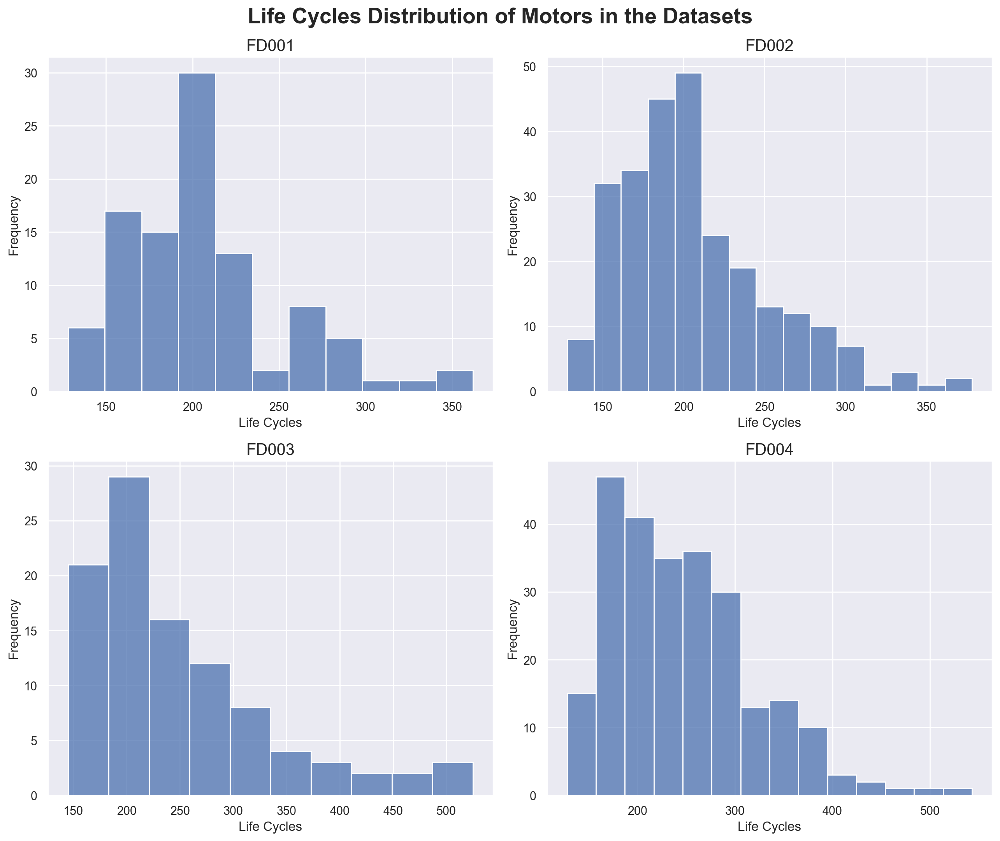

In [23]:
sqr_n= round(np.sqrt(len(train_data)))
plt.figure(figsize=(13, 11))
for i, train_data_x in enumerate(train_data):
    plt.subplot(sqr_n,sqr_n,i + 1)
    sns.histplot(x=train_data_x.groupby('UnitNumber')['RUL'].max(), bins='auto')
    plt.title('FD00' + str(i + 1), fontsize=15)
    plt.xlabel('Life Cycles')
    plt.ylabel('Frequency')
plt.suptitle('Life Cycles Distribution of Motors in the Datasets', fontsize=20, fontweight='bold')
plt.tight_layout()
plt.show()

Findings: 
* The distributions of life cycles in the four datasets are not the same, but they are very similar.
* Some of the motors in datasets in fault mode (FD003 and FD004) two reach much higher life cycles.

## Analyzing Feature + Target Correlation

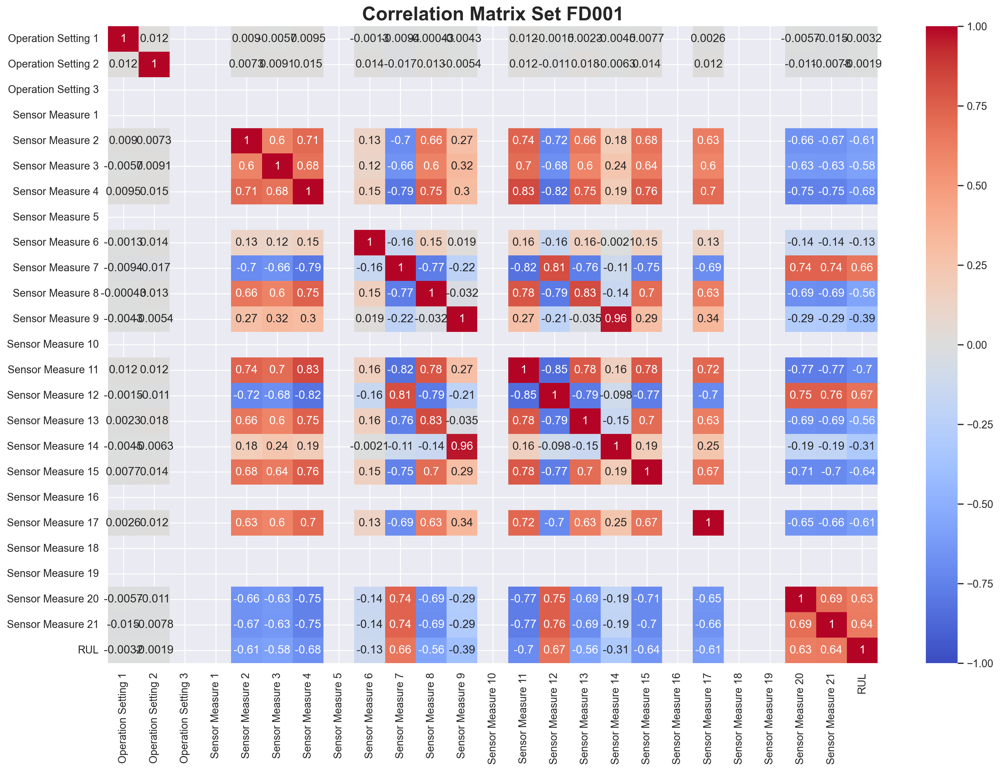

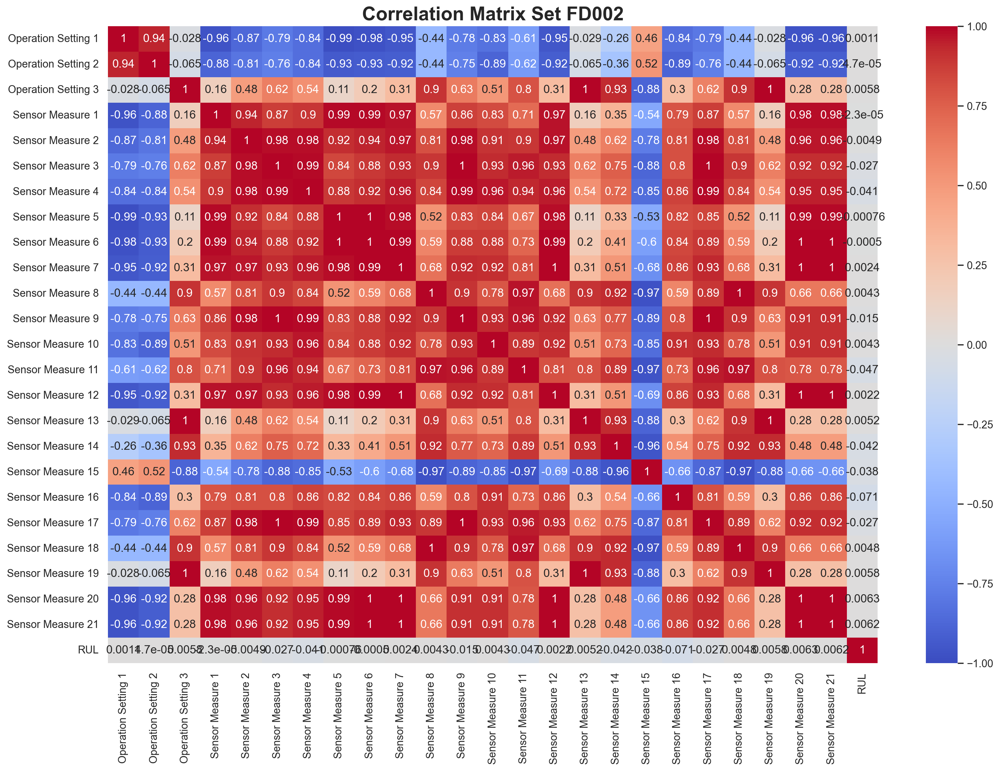

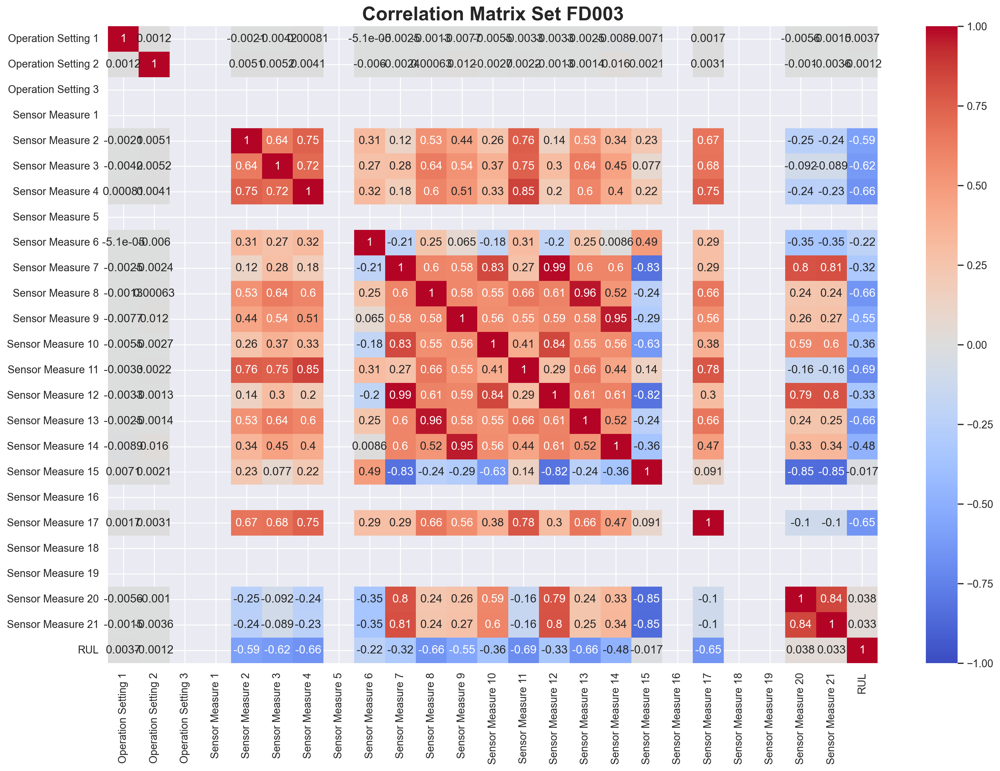

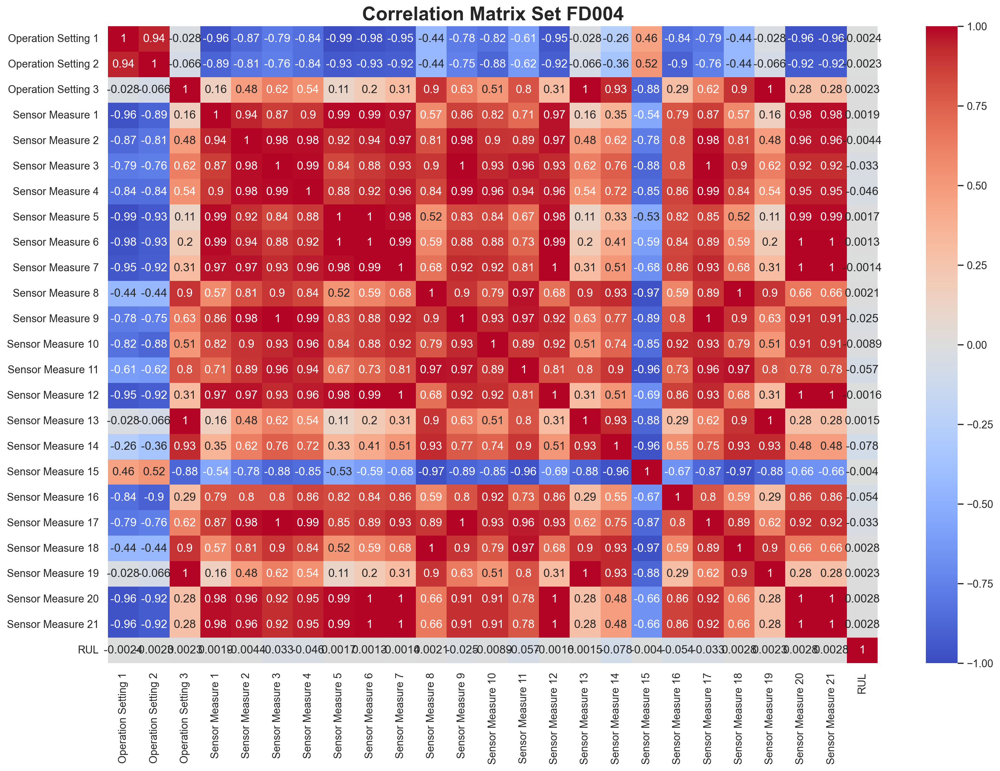

In [24]:
for i, train_data_x in enumerate(train_data):
    correlation = train_data_x.drop(['UnitNumber', 'Cycle'], axis=1).corr()

    fig = plt.figure(figsize = (18,12))
    sns.heatmap(correlation, annot=True, vmin=-1, vmax=1, cmap="coolwarm")
    plt.title('Correlation Matrix Set FD00' + str(i + 1), fontsize=20, fontweight='bold')

Text(0.5, 1.0, 'FD001 and FD003 correlation with RUL')

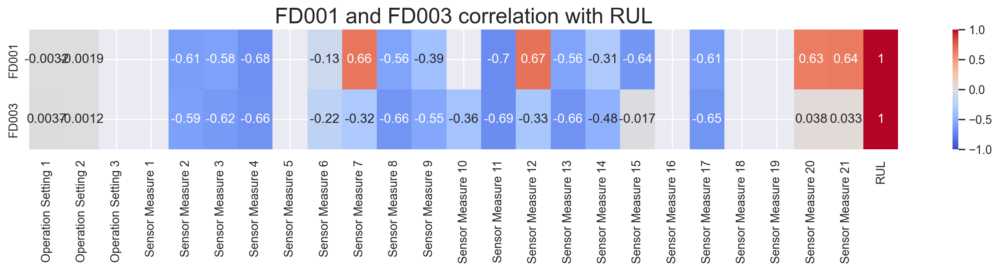

In [25]:
correlation_1 = train_data_1.drop(['UnitNumber', 'Cycle'], axis=1).corr()
correlation_3 = train_data_3.drop(['UnitNumber', 'Cycle'], axis=1).corr()

columns = pd.Index(['Dataset'])
columns.append(correlation_1.columns)
df_rul_1_3 = pd.DataFrame(columns=columns)
df_rul_1_3['FD001'] = correlation_1['RUL']
df_rul_1_3['FD003'] = correlation_3['RUL']

fig = plt.figure(figsize = (18,2))
sns.heatmap(df_rul_1_3[df_rul_1_3.columns.drop('Dataset')].transpose(), annot=True, vmin=-1, vmax=1, cmap="coolwarm")
plt.title('FD001 and FD003 correlation with RUL', fontsize=20)

Findings:
* The correlation from the datasets under condition SIX (FD002 and FD004) vary significantly compared to the datasets under condition ONE for the attributes: 'Operation Setting 3', 'Sensor Measure 1', 'Sensor Measure 5', 'Sensor Measure 16', 'Sensor Measure 18', 'Sensor Measure 19'
* Especially the correlation with the RUL is significantly lower in the datasets under condition SIX
* The features of the datasets under condition SIX have nearly no correlation (not a high positive or negative correlation) with the RUL. 
* The correlation between RUL and features of FD001 and FD003 vary also for some measures significantly, e.g. Sensor Measure 20 and 21

Note: The findings above only describe the correlation between single values of the time series, not in the context of the previous values.

## Analyzing Sensor Measures Time Series by one example motor
We will visualize the time series of the sensor measures for example motor 1 in the datasets FD001 and FD002. By this we can get a better understanding of the sensor measures and their behavior over time and how they differ between the datasets when the motor is in different conditions. We take dataset FD001 and FD002 as an example, since FD003 and FD004 have the same characteristics as FD001 and FD002.

### Dataset FD001

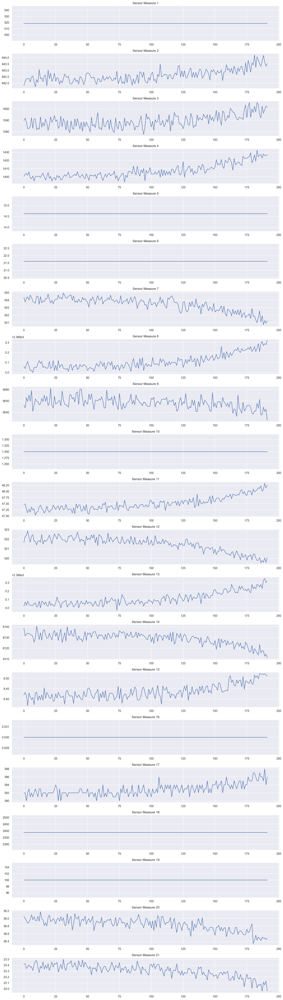

In [26]:
plot_sensor_measures_from_motor(config=config, motor_id=1, data=train_data_1, name_of_dataset='FD001', show=True, save=False)

Findings:
* The signal from Sensor Measure 1, 5, 6, 10, 16, 18, 19 has a constant value.
* For all other Sensor Measures, a change in the value around which they oscillate can be observed with a decrease in the RUL

### Dataset FD002

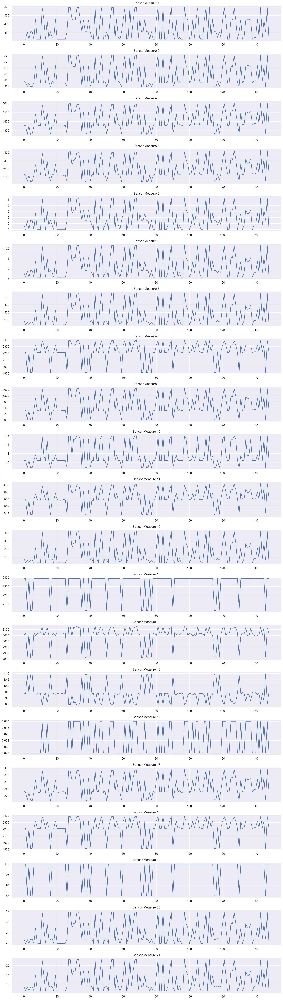

In [27]:
plot_sensor_measures_from_motor(config=config, motor_id=1, data=train_data_2, name_of_dataset='FD001', show=True, save=False)

Findings:
* Compared to the time series of motor 1 in the FD001 dataset all Sensor Measures are not constant
* The most Sensor Measures show oscillating patterns

## Analyzing Sensor Measures Time Series by all motors
We will visualize the time series of the sensor measures for all motors in the datasets FD001. By this we can get an overall look and also see the distribution of the sensor measures over motors to detect if sensor measures show trends relative to the RUL.

### Dataset FD001

**How does the time series of the sensor measures look like for all motors? Is there a trend relative to the RUL?**

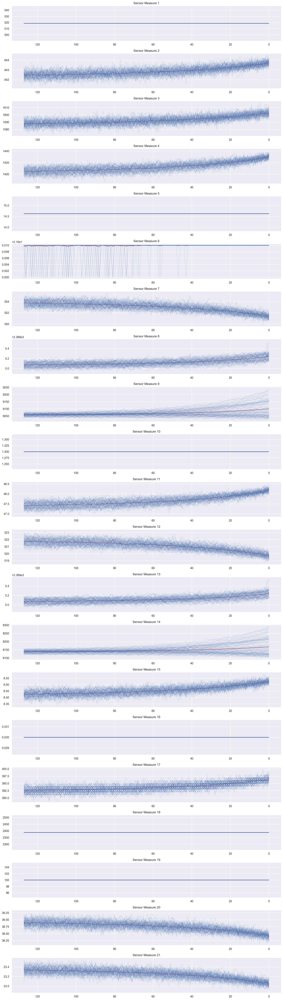

In [28]:
plot_sensor_measures_from_dataset(config=config, data=train_data_1, name_of_dataset='FD001', show=True, save=False)

for i, train_data_x in enumerate(train_data):
    plot_sensor_measures_from_dataset(config, train_data_x, 'FD00' + str(i + 1), show=False, save=True)

Findings:
* The signal from Sensor Measure 6 does not have for all motors a constant value.
* The most Sensor Measures have a similar behavior for all motors.

**How is the distribution of the sensor measures?**

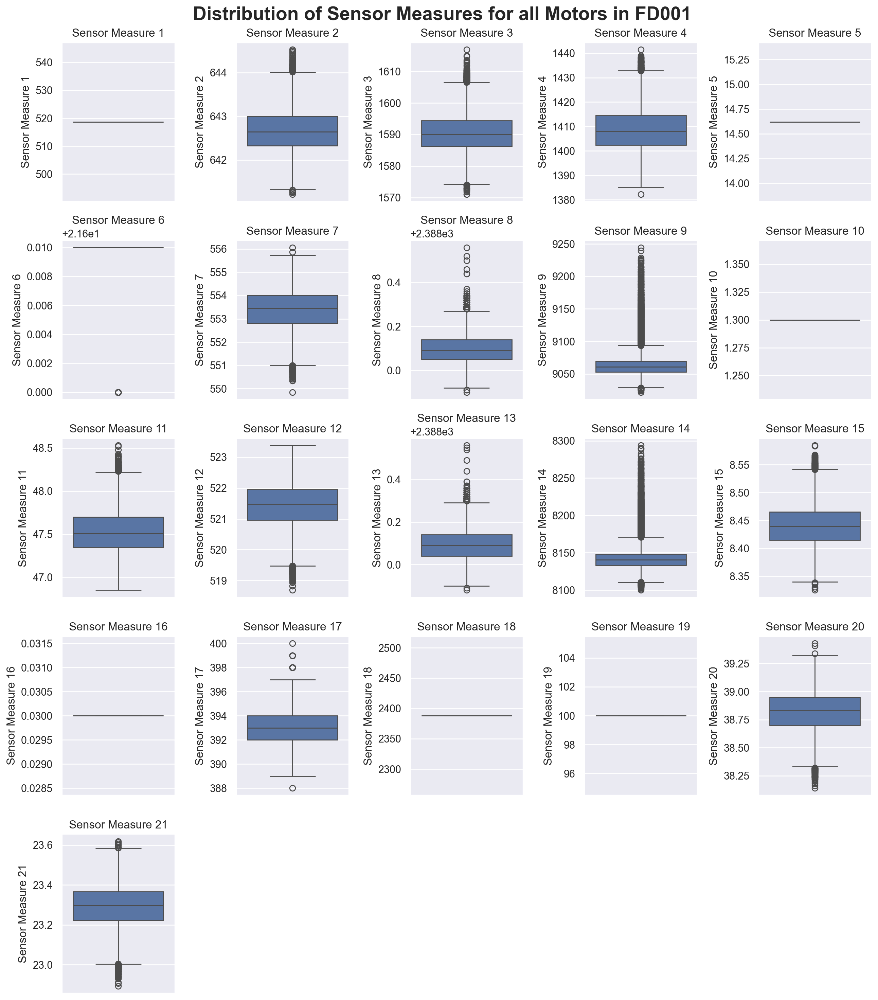

In [29]:
# sns boxplot for all sensor measures
sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data_1.keys()))
num_cols = 5

fig = plt.figure(figsize=(13, 15))
for i, sensor_measure_column_name in enumerate(sensor_measure_columns_names):
    ax = plt.subplot(len(sensor_measure_columns_names)//num_cols + 1, num_cols, i+1)
    sns.boxplot(y=sensor_measure_column_name, data=train_data_1, ax=ax)
    ax.set_title(sensor_measure_column_name)
plt.suptitle('Distribution of Sensor Measures for all Motors in FD001', fontsize=20, fontweight='bold')
plt.tight_layout()
plt.show()

Findings:
* Same as before we can see that columns `SensorMeasure1`, `SensorMeasure5`, `SensorMeasure6`, `SensorMeasure10`, `SensorMeasure16`, `SensorMeasure18` and `SensorMeasure19` have constant values for all motors.
* Maybe check for value counts, if a colum has mor than 1 but less than 5 unique values, it can be a categorical column or dropped since it does not provide much information.
--> Check out how it is with this case in all datasets, we know that we have features with constant values for all motors but if a feature has 2 unique values it is also not very informative for us:

### Inspect features with a low value count
We will inspect the value counts of the features with less than 5 but more than 1 unique values for all datasets.

In [30]:
# get value counts for features with less than 5 unique values
for i, train_data_x in enumerate(train_data):
    print('*'*50)
    print(f"Dataset FD00{i+1}")
    print('*'*50)
    for column in train_data_x.columns:
        if 1 < train_data_x[column].nunique() < 5:
            print(train_data_x[column].value_counts())
            print()

**************************************************
Dataset FD001
**************************************************
Sensor Measure 6
21.61    20225
21.60      406
Name: count, dtype: int64

**************************************************
Dataset FD002
**************************************************
Operation Setting 3
100.0    45757
60.0      8002
Name: count, dtype: int64

Sensor Measure 16
0.02    35879
0.03    17880
Name: count, dtype: int64

Sensor Measure 19
100.00    45757
84.93      8002
Name: count, dtype: int64

**************************************************
Dataset FD003
**************************************************
Sensor Measure 10
1.30    21814
1.31     2740
1.32      157
1.29        9
Name: count, dtype: int64

**************************************************
Dataset FD004
**************************************************
Operation Setting 3
100.0    52110
60.0      9139
Name: count, dtype: int64

Sensor Measure 16
0.02    41328
0.03    19921
Name: count

In [31]:
# get total number of columns with less than 5 but more than 1 unique values
print(f"Number of columns with less than 5 unique values in FD001: {len([column for column in train_data_1.columns if 1 < train_data_1[column].nunique() < 5])}")
print(f"Number of columns with less than 5 unique values in FD002: {len([column for column in train_data_2.columns if 1 < train_data_2[column].nunique() < 5])}")
print(f"Number of columns with less than 5 unique values in FD003: {len([column for column in train_data_3.columns if 1 < train_data_3[column].nunique() < 5])}")
print(f"Number of columns with less than 5 unique values in FD004: {len([column for column in train_data_4.columns if 1 < train_data_4[column].nunique() < 5])}")

Number of columns with less than 5 unique values in FD001: 1
Number of columns with less than 5 unique values in FD002: 3
Number of columns with less than 5 unique values in FD003: 1
Number of columns with less than 5 unique values in FD004: 3


Findings:
* There are other features in the datasets that have less than 5 unique values but more than 1. --> chose unique values threshold to drop them in data cleaning process

## Check the density distribution of the datasets
For later on different data cleaning techniques or other assumptions which have ti be made about the data distribution it is important to know how the data is distributed. Therefore, we will check the density distribution of the datasets, so we can already see if the data is kinda normally distributed or not.
For Training the data it is also important to know if the given test data is distributed the same way as the training data. Therefore, we will also check the density distribution of the test data and compare them. If they differed much, without any transformation of the data, the model would not be able to generalize well and the results would be terrible on the test data.

In [32]:
# density distribution of the datasets
def plot_density_distribution(train_data, test_data, name_of_dataset, show=True, save=False):
    num_cols = 4
    fig = plt.figure(figsize=(13, 15))
    for i, column in enumerate(train_data.columns):
        ax = plt.subplot(len(train_data.columns)//num_cols + 1, num_cols, i+1)
        sns.kdeplot(train_data[column], ax=ax, label='train', color='blue', warn_singular=False)
        sns.kdeplot(test_data[column], ax=ax, label='test', color='red', warn_singular=False)

    plt.legend()
    plt.suptitle(f'Density Distribution of the Datasets {name_of_dataset}', fontsize=20, fontweight='bold')
    plt.tight_layout()
    if show:
        plt.show()
    if save:
        timestamp = time.strftime("%Y%m%d-%H%M%S")
        fig.savefig(f"{config['paths']['plot_dir']}ex2_density_distribution_{name_of_dataset}_{timestamp}.png")
    plt.close()

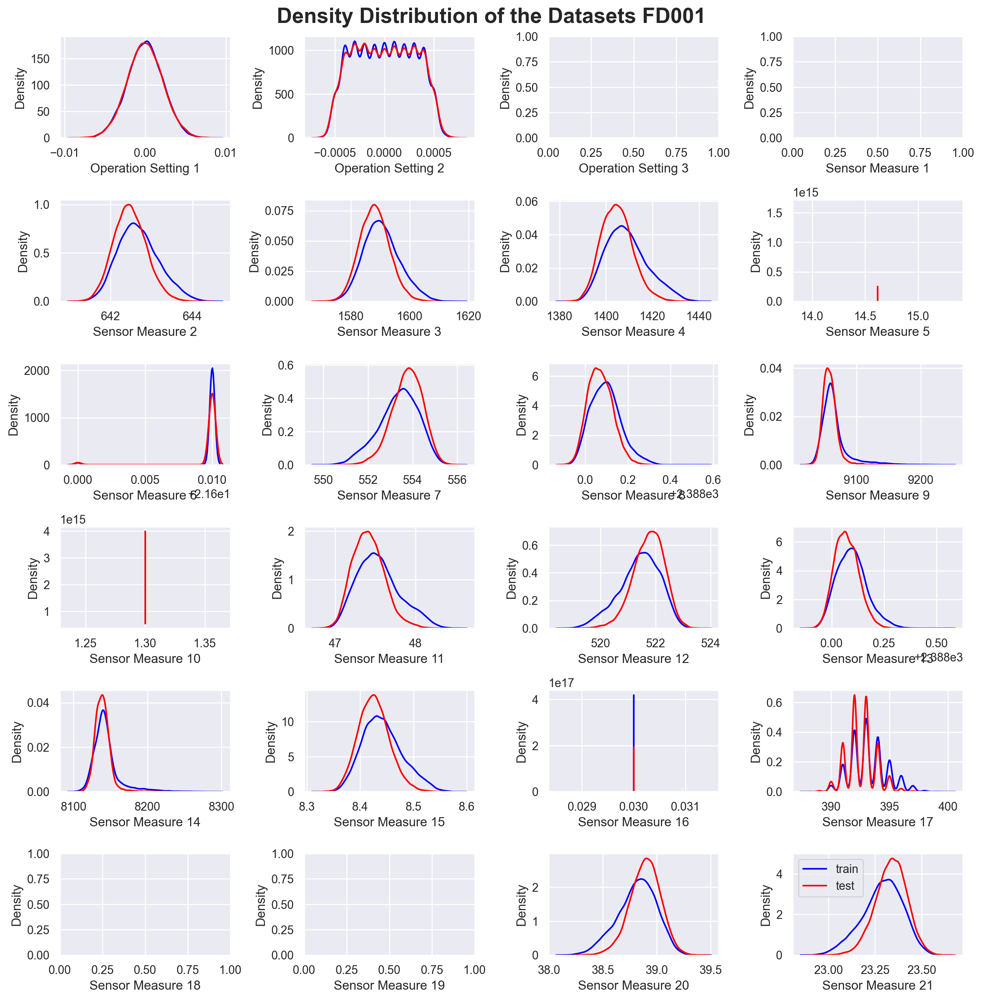

In [33]:
plot_density_distribution(train_data_1.drop(["RUL", "UnitNumber", "Cycle"], axis=1), test_data_1.drop(["UnitNumber", "Cycle"], axis=1), 'FD001', show=True, save=False)

Findings Dataset FD001:
* The density distribution of the training and test data is very similar.
* Most features show a bell-shaped curve, which indicates a normal distribution.
* Diagrams are empty or show only one peak, due to the fact that the features have constant values and thus no density distribution can be calculated.
* `Operation Setting 2` shows some wave patterns in the density distribution, but only at the top. This is may be due to the fact that the values are not continuous but discrete. One can thus think about binarizing the values or also just dropping the column.
* `Sensor Measure 6` shows a very high peak on the right side of the density distribution. This could be due to some rare outliers in the data. -> Check for outliers in the data and handle them in the data cleaning process

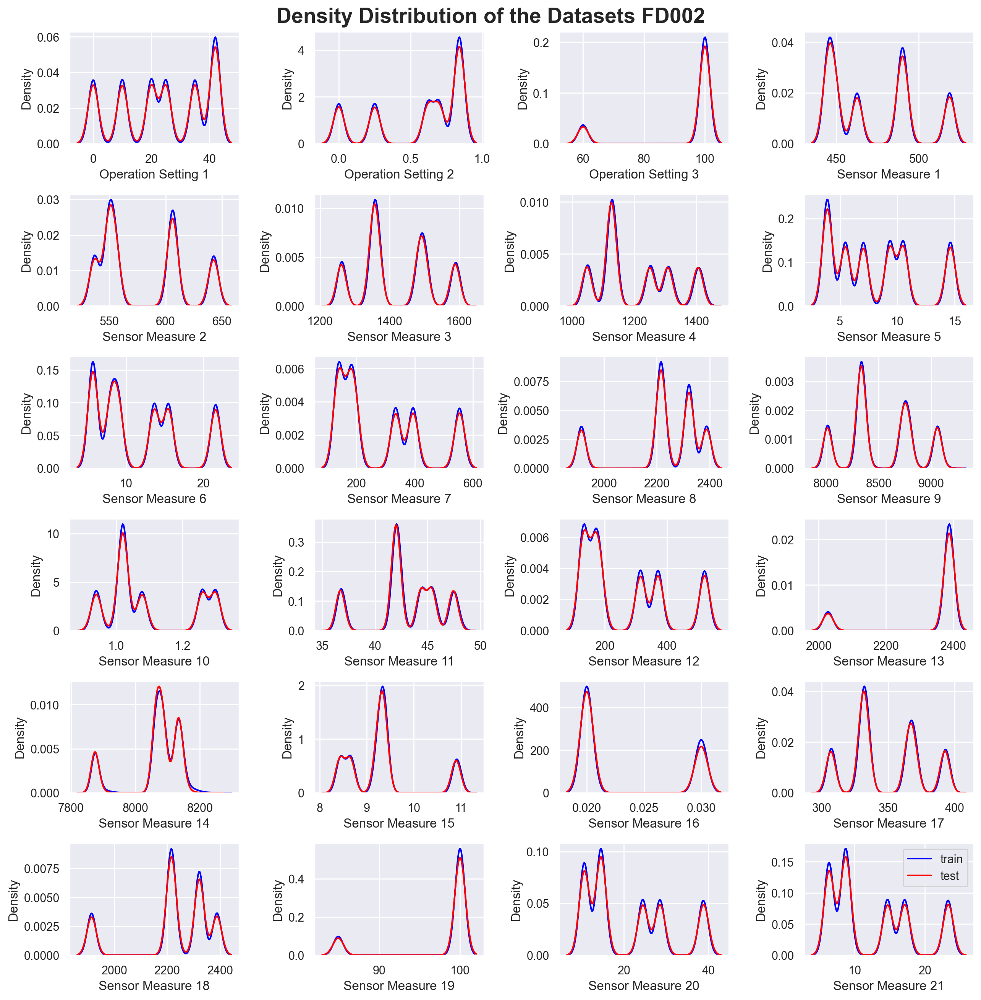

In [34]:
plot_density_distribution(train_data_2.drop(["RUL", "UnitNumber", "Cycle"], axis=1), test_data_2.drop(["UnitNumber", "Cycle"], axis=1), 'FD002', show=True, save=False)

Findings Dataset FD002:
* The density distribution of the training and test data is very similar.
* All features show a really skewed density distribution, showing multiple peaks without a trend to be seen. This excludes a normal distribution.
* Dataset FD002 once again shows how much it differs to FD001. This can be due to the different conditions under which the motors are running in these sets.

## Inspect number of peaks of the sensor measures
We will extract the number of peaks of the sensor measures for all motors in the datasets FD001 and FD002. By this we can get an overall look can also check how much the number of peaks of the sensor measures differ between the datasets. As representation, we're only going to take dataset FD001 and FD002. Since dataset FD003 and FD004 have the same characteristics as FD001 and FD002.

In [35]:
%%time
peaks_train_1 = extract_num_of_peaks_from_sensor_signals(train_data_1, "Sensor")
peaks_train_2 = extract_num_of_peaks_from_sensor_signals(train_data_2, "Sensor")
peaks_train_3 = extract_num_of_peaks_from_sensor_signals(train_data_3, "Sensor")
peaks_train_4 = extract_num_of_peaks_from_sensor_signals(train_data_4, "Sensor")

2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 1: 0
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 2: 6783
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 3: 6843
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 4: 6904
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 5: 0
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 6: 367
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 7: 6840
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measure 8: 6415
2024-06-01 20:48:38 [src.feature_engineering:35] [DEBUG] >>>> Absolut number of peaks for Sensor Measur

In [36]:
# check for difference between sets
df_peaks = pd.DataFrame(list(peaks_train_1.items()), columns=['feature', 'num_peaks_FD001'])
# use map
df_peaks['num_peaks_FD002'] = df_peaks['feature'].map(peaks_train_2)
df_peaks['num_peaks_FD003'] = df_peaks['feature'].map(peaks_train_3)
df_peaks['num_peaks_FD004'] = df_peaks['feature'].map(peaks_train_4)
df_peaks['rel_diff_1_2'] = (df_peaks['num_peaks_FD001'] - df_peaks['num_peaks_FD002']) / df_peaks['num_peaks_FD001']
df_peaks['rel_diff_1_3'] = (df_peaks['num_peaks_FD001'] - df_peaks['num_peaks_FD003']) / df_peaks['num_peaks_FD001']
df_peaks['rel_diff_2_3'] = (df_peaks['num_peaks_FD002'] - df_peaks['num_peaks_FD003']) / df_peaks['num_peaks_FD002']
df_peaks['rel_diff_2_4'] = (df_peaks['num_peaks_FD002'] - df_peaks['num_peaks_FD004']) / df_peaks['num_peaks_FD002']
df_peaks

,feature,num_peaks_FD001,num_peaks_FD002,num_peaks_FD003,num_peaks_FD004,rel_diff_1_2,rel_diff_1_3,rel_diff_2_3,rel_diff_2_4
0,Sensor Measure 1,0,16522,0,18845,-inf,NaN,1.000000,-0.140600
1,Sensor Measure 2,6783,17901,8221,20413,-1.639098,-0.212001,0.540752,-0.140327
2,Sensor Measure 3,6843,17865,8220,20364,-1.610697,-0.201228,0.539882,-0.139882
3,Sensor Measure 4,6904,17908,8249,20400,-1.593859,-0.194815,0.539368,-0.139156
4,Sensor Measure 5,0,16504,0,18821,-inf,NaN,1.000000,-0.140390
5,Sensor Measure 6,367,16804,1868,19176,-44.787466,-4.089918,0.888836,-0.141157
6,Sensor Measure 7,6840,17904,8170,20379,-1.617544,-0.194444,0.543677,-0.138237
7,Sensor Measure 8,6415,17792,7739,20238,-1.773500,-0.206391,0.565029,-0.137478
8,Sensor Measure 9,6826,17899,8219,20348,-1.622180,-0.204073,0.540812,-0.136823
9,Sensor Measure 10,0,15409,327,17598,-inf,-inf,0.978779,-0.142060


In [37]:
print(f"Mean relative difference between FD001 and FD002: {df_peaks['rel_diff_1_2'].mean():.4f}")
print(f"Mean relative difference between FD001 and FD003: {df_peaks['rel_diff_1_3'].mean():.4f}")
print(f"Mean relative difference between FD002 and FD003: {df_peaks['rel_diff_2_3'].mean():.4f}")
print(f"Mean relative difference between FD002 and FD004: {df_peaks['rel_diff_2_4'].mean():.4f}")
print(f"Shape comparison of datasets: FD001 {train_data_1.shape}, FD002 {train_data_2.shape}, FD003 {train_data_3.shape}, FD004 {train_data_4.shape}")

Mean relative difference between FD001 and FD002: -inf
Mean relative difference between FD001 and FD003: -inf
Mean relative difference between FD002 and FD003: 0.6944
Mean relative difference between FD002 and FD004: -0.1384
Shape comparison of datasets: FD001 (20631, 27), FD002 (53759, 27), FD003 (24720, 27), FD004 (61249, 27)


Findings:
* The number of peaks of the sensor measures in the datasets FD001 and FD003 are very similar showing showing a low relative difference expect the -inf values which are due to the fact that the number of peaks in FD003 is 0 for some sensor measures.
* The number of peaks of the sensor measures in the datasets FD002 and FD004 are very similar showing showing a low relative difference with a mean of -0.1384. Meaning that FD002 has on average 13.84% more peaks than FD004.
* The number of peaks of the sensor measures in the datasets FD001 and FD002 are very different and also have a -inf value for some sensor measures.
* The number of peaks of the sensor measures in the datasets FD002 and FD003 differ on average by 0.6944. Meaning that FD002 has on average 69.44% more peaks than FD003.

All these differences can also be due to some that the datasets are of slightly different sizes. But a clear trend can be seen as also in the other plots, that the datasets FD001 and FD003 are more similar to each other and FD002 and FD004 are more similar to each other. This is probably due to the different conditions under which the motors are running in these sets.

# Playground
In the following we will keep the code snippets that we used to explore the data and try out different methods. This is a playground area is experimental and not a proven part of the EDA.

**Preprocessing: Savitzky-Golay Filter**

In [38]:
from scipy.signal import savgol_filter
# TODO: Add comments
def convert_sensor_signals_with_savgol(data, sensor_measure_columns_names, window_length, polyorder, deriv=0):
    data_savgol = data.copy()
    for sensor_measure_column_name in sensor_measure_columns_names:
        data_savgol[sensor_measure_column_name] = data.groupby('UnitNumber')[sensor_measure_column_name].transform(lambda x: savgol_filter(x, window_length=window_length, polyorder=polyorder, deriv=deriv))
    return data_savgol

In [40]:
sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data_1.keys()))
train_data_1_savgol = convert_sensor_signals_with_savgol(train_data_1, sensor_measure_columns_names, window_length=5, polyorder=2)

plot_sensor_measures_from_dataset(data=train_data_1_savgol, name_of_dataset='FD001', show=True, save=False, config=config)

TypeError: plot_sensor_measures_from_dataset() missing 1 required positional argument: 'config'

In [ ]:
sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data_2.keys()))
train_data_2_savgol = convert_sensor_signals_with_savgol(train_data_2, sensor_measure_columns_names, window_length=10, polyorder=2)

plot_sensor_measures_from_dataset(data=train_data_2_savgol, name_of_dataset='FD002', show=True, save=False)

In [ ]:
def plot_sensor_measures_from_dataset(train_data, name_of_dataset, show=True, save=False):
    sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data.keys()))
    number_of_columns = len(sensor_measure_columns_names)
    fig = plt.figure(figsize=(15,2.5*len(sensor_measure_columns_names)))
    for i,v in enumerate(range(number_of_columns)):
        a = plt.subplot(number_of_columns,1,v+1)
        min_rul = train_data.groupby("UnitNumber")["RUL"].max().min()
        #a.plot(range(min_rul), train_data_1[train_data_1["RUL"] <= min_rul].groupby("RUL")[sensor_measure_columns_names[v]].mean(), color='r')
        for motor_id in train_data['UnitNumber'].unique():
            a.plot(range(min_rul-1, -1, -1), train_data[train_data["UnitNumber"]==motor_id][sensor_measure_columns_names[v]][-min_rul:], alpha=0.1, color='b')
        a.invert_xaxis()
        a.title.set_text(sensor_measure_columns_names[v])
        plt.tight_layout()
    if show:
        plt.show()
    if save:
        timestamp = time.strftime("%Y%m%d-%H%M%S")
        fig.savefig(f"{config['paths']['plot_dir']}ex2_topic_dataset_{name_of_dataset}_{timestamp}.png")
    plt.close()

In [ ]:
sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data_1.keys()))
train_data_1_savgol_1 = convert_sensor_signals_with_savgol(train_data_1, sensor_measure_columns_names, window_length=5, polyorder=2, deriv=1)

plot_sensor_measures_from_dataset(train_data=train_data_1_savgol_1, name_of_dataset='FD001', show=True, save=False)